# OLIST Part 1 :  Customer analysis

In [1]:
# Import the necessaries libraries
import pandas as pd
import numpy as np
from functools import reduce

# matplotlib and seaborn for plotting
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

import plotnine as pn
pn.options.dpi=300

import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# File system and time mangement
import os
import re
from dateutil.relativedelta import relativedelta

# Suppress warnings 
import warnings
warnings.filterwarnings('ignore')

## Data attributes

In [2]:
# List files available
inputWD = os. getcwd()+"\\input\\"
print('Source files:', os.listdir(inputWD))

Source files: ['olist_customers_dataset.csv', 'olist_geolocation_dataset.csv', 'olist_orders_dataset.csv', 'olist_order_items_dataset.csv', 'olist_order_payments_dataset.csv', 'olist_order_reviews_dataset.csv', 'olist_products_dataset.csv', 'olist_sellers_dataset.csv', 'product_category_name_translation.csv', 'rfm_reference.txt']


In [3]:
#import the product traduction
product_category = pd.read_csv(inputWD + "product_category_name_translation.csv")

#generate the import files list
to_be_removed = ['rfm_reference.txt','product_category_name_translation.csv','.ipynb_checkpoints']
import_files =  [x for x in os.listdir(inputWD) if (x not in to_be_removed)]

#import other files
for s in import_files:
    pattern = "olist\_(.*?)\_dataset"
    substring = re.search(pattern, s).group(1)  #substract a name from the csv file
    locals()[substring] = pd.read_csv(inputWD + s) #modify the string to variable name and import csv file
    print('-', substring, 'dataset shape:', locals()[substring].shape, 
          '(duplicated lines:', locals()[substring].duplicated().sum(),')') 


- customers dataset shape: (99441, 5) (duplicated lines: 0 )
- geolocation dataset shape: (1000163, 5) (duplicated lines: 261831 )
- orders dataset shape: (99441, 8) (duplicated lines: 0 )
- order_items dataset shape: (112650, 7) (duplicated lines: 0 )
- order_payments dataset shape: (103886, 5) (duplicated lines: 0 )
- order_reviews dataset shape: (99224, 7) (duplicated lines: 0 )
- products dataset shape: (32951, 9) (duplicated lines: 0 )
- sellers dataset shape: (3095, 4) (duplicated lines: 0 )


**Before diving into insights from the data, duplicate entries were removed from the data.**

In [4]:
geolocation.drop_duplicates(inplace=True)
print('-', 'geolocation without duplicates dataset shape:', geolocation.shape,) 

- geolocation without duplicates dataset shape: (738332, 5)


**Mapping order_id to customers_unique_id**

In [5]:
customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [6]:
orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


 The customer_id in the orders dataset is a temporel id created during the order

In [7]:
#mapping orders customers    
customer_order_map=orders[['order_id','customer_id']]\
.merge(customers[['customer_id','customer_unique_id']],how='left',on='customer_id',left_index=True).drop(columns='customer_id')

customer_order_map.head()

,order_id,customer_unique_id
70296,e481f51cbdc54678b7cc49136f2d6af7,7c396fd4830fd04220f754e42b4e5bff
77027,53cdb2fc8bc7dce0b6741e2150273451,af07308b275d755c9edb36a90c618231
554,47770eb9100c2d0c44946d9cf07ec65d,3a653a41f6f9fc3d2a113cf8398680e8
61081,949d5b44dbf5de918fe9c16f97b45f8a,7c142cf63193a1473d2e66489a9ae977
67263,ad21c59c0840e6cb83a9ceb5573f8159,72632f0f9dd73dfee390c9b22eb56dd6


In [8]:
customer_order_map.isna().sum()

order_id              0
customer_unique_id    0
dtype: int64

## Data exploration

Let us now look at the total number of products, transactions, and customers in the data

In [9]:
pd.DataFrame([{ 'transactions': len(orders['order_id'].value_counts()),
               'from':orders['order_purchase_timestamp'].min(),
               'to':orders['order_purchase_timestamp'].max(),
               'customers': len(customers['customer_unique_id'].value_counts()),
               'products': len(products['product_id'].value_counts()),
               'sellers': len(sellers['seller_id'].value_counts())
              }], index = ['quantity'])

,transactions,from,to,customers,products,sellers
quantity,99441,2016-09-04 21:15:19,2018-10-17 17:30:18,96096,32951,3095


### Order features 

In [10]:
#histogram
fig = px.histogram(orders, x="order_purchase_timestamp", color="order_status")

fig.update_layout(bargap=0.2)
fig.show()

In [11]:
#change order dates into datetime format
cols = orders.columns[3:]
orders[cols] = orders[cols].apply(pd.to_datetime, errors='coerce')

#calculate actions' durations
orders['order_approval_hours'] = (orders['order_approved_at']-orders['order_purchase_timestamp']
                                )/pd.to_timedelta(1, unit='h')
orders['order_delivery_days'] = (orders['order_delivered_customer_date']-orders['order_delivered_carrier_date']
                                )/pd.to_timedelta(1, unit='d')
orders['order_delivery_delay'] = (orders['order_delivered_customer_date']-orders['order_estimated_delivery_date']
                                 )/pd.to_timedelta(1, unit='d')

#calculate rencency days
orders['recency'] = (orders['order_purchase_timestamp']-orders['order_purchase_timestamp'].max())\
/pd.to_timedelta(1, 'day')

#keep valided orders
df_orders = orders.query("order_status=='delivered' or order_status=='shipped'")\
.drop(columns = ['order_status', 'order_approved_at','order_delivered_carrier_date',
             'order_delivered_customer_date','order_estimated_delivery_date'])


validated_orders = df_orders['order_id'].unique().tolist()
validated_customers = df_orders['customer_id'].unique().tolist()

In [12]:
df_orders

,order_id,customer_id,order_purchase_timestamp,order_approval_hours,order_delivery_days,order_delivery_delay,recency
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017-10-02 10:56:33,0.178333,6.062650,-7.107488,-380.273438
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018-07-24 20:41:37,30.713889,12.039410,-5.355729,-84.867141
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018-08-08 08:38:49,0.276111,9.178113,-17.245498,-70.369086
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017-11-18 19:28:06,0.298056,9.450498,-12.980069,-332.918194
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018-02-13 21:18:39,1.030556,1.937824,-9.238171,-245.841424
...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,2017-03-09 09:54:05,0.000000,7.159699,-10.369433,-587.316817
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,2018-02-06 12:58:58,0.194167,20.760579,-1.265324,-253.188426
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,2017-08-27 14:46:43,0.292500,23.605451,-5.524803,-416.113600
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,2018-01-08 21:28:27,0.131667,13.331840,-20.018819,-281.834618


## Payment features

In [13]:
#add order information to payment
payments = order_payments.merge(orders,how='left',on="order_id",left_index=True)

#histogram of sales
fig = px.histogram(payments.query("order_id==@validated_orders"), 
                   x="order_purchase_timestamp", y='payment_value',
                   color='payment_type', title='sales')
fig.update_layout(bargap=0.2)

In [74]:
#violin graph
fig = px.violin(payments, 
                y='order_approval_hours', x='order_status', color='payment_type', 
                box=True)
fig.show()

**Payment delta**

In [73]:
#check out payment delta
value_payment=order_payments[['order_id','payment_value']].groupby('order_id').sum()
value_price_freight = order_items[['order_id','price','freight_value']].groupby('order_id').sum()


payment_verif = pd.merge(value_payment, value_price_freight, on='order_id', how='left', left_index=True)\
.query("order_id==@validated_orders")

#calculate the delta
payment_verif["price_freight"] = payment_verif['price'] + payment_verif['freight_value']
payment_verif['payment_delta'] = payment_verif['payment_value'] - payment_verif['price_freight']

payment_verif["dedit_credit"] = payment_verif['payment_delta']\
.apply(lambda x: 'dedit' if x<0 else 'credit')

#filter difference more than 1 Brazilian real
mask=payment_verif['payment_delta'].abs()>1
df_verif = payment_verif[mask]

print(df_verif.shape)
df_verif.head()

(247, 6)


,payment_value,price,freight_value,price_freight,payment_delta,dedit_credit
order_id,,,,,,
00789ce015e7e5791c7914f32bb4fad4,190.81,154.00,14.83,168.83,21.98,credit
016726239765c18f66826453f39c64e3,265.77,219.99,15.14,235.13,30.64,credit
01e51b7c3025655646143d09b911e1d7,35.02,19.00,14.10,33.10,1.92,credit
028aa7c930356788f861ed1b7f984819,62.94,39.90,17.63,57.53,5.41,credit
02f4dd90ba0feb8ec394cac05862d2b5,141.65,79.90,51.06,130.96,10.69,credit


In [64]:
fig = px.scatter(df_verif, x="payment_value", y="payment_delta",size="price_freight", color="dedit_credit",size_max=60)
fig.show()

In [18]:
#get payment details per order
df_payments=pd.concat([order_payments, pd.get_dummies(order_payments[['payment_type']])], axis=1)\
.groupby('order_id').sum().drop(columns=['payment_sequential','payment_installments'])\
.query("order_id==@validated_orders")\
.merge(order_payments.groupby('order_id').agg({'payment_sequential':'max','payment_installments':'max'}),
       how='left',on='order_id',left_index=True)\
.reset_index()\
.merge(customer_order_map, on='order_id',how='left',left_index=True).groupby('customer_unique_id').sum()

print(df_payments.shape)
df_payments.head()

(94398, 8)


,payment_value,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_not_defined,payment_type_voucher,payment_sequential,payment_installments
customer_unique_id,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,141.90,0,1,0,0,0,1,8
0000b849f77a49e4a4ce2b2a4ca5be3f,27.19,0,1,0,0,0,1,1
0000f46a3911fa3c0805444483337064,86.22,0,1,0,0,0,1,8
0000f6ccb0745a6a4b88665a16c9f078,43.62,0,1,0,0,0,1,4
0004aac84e0df4da2b147fca70cf8255,196.89,0,1,0,0,0,1,6


In [19]:
df_payments.isna().sum()

payment_value               0
payment_type_boleto         0
payment_type_credit_card    0
payment_type_debit_card     0
payment_type_not_defined    0
payment_type_voucher        0
payment_sequential          0
payment_installments        0
dtype: int64

### Product features

In [20]:
#get english category names per product
categories=pd.merge(order_items,products, how='left', on='product_id',left_index=True)\
.merge(product_category, how='left', on='product_category_name',left_index=True)\
.rename(columns={"order_item_id": "quantity"})\
.merge(orders,how='left',on="order_id",left_index=True)

#histogram
fig = px.histogram(categories.query("order_id==@validated_orders"), x="product_category_name_english",y="price",
                  color='quantity',title='sold products').update_xaxes(categoryorder='total descending')
fig.update_layout(bargap=0.2)

In [21]:
#histogram
fig = px.bar(categories.query("order_id!=@validated_orders"),
             x="product_category_name_english",y="quantity",
                 hover_data=['product_id','price', 'shipping_limit_date','product_category_name_english'],
                  color='order_status',title='products status')
fig.show()

In [22]:
#getting the list of all product categories
cat_list = categories.product_category_name_english.value_counts().index.tolist()
#lable encoding products variable
cat_dummies = pd.get_dummies(categories.product_category_name_english)
#keeping only top 5 sales and put all the others into one variable
cat_lencoding = pd.concat([cat_dummies[cat_list[:5]], pd.DataFrame(cat_dummies[cat_list[5:]].sum(axis=1))], axis=1)
#renaming the new df
cat_lencoding.columns = ['prod-'+ cat for cat in cat_list[:5]]+ ['prod-others']
#adding label encoding variables
df_cat_lencoding = pd.concat([categories,cat_lencoding],axis=1)

#grouping by order_id
agg_list = cat_lencoding.columns.tolist()+['quantity']
df_categories = df_cat_lencoding.query("order_id==@validated_orders").groupby('order_id')[agg_list].sum().reset_index()\
.merge(customer_order_map, on='order_id',how='left',left_index=True).groupby('customer_unique_id').sum()
print(df_categories.shape)        
df_categories.head()

(94398, 7)


,prod-bed_bath_table,prod-health_beauty,prod-sports_leisure,prod-furniture_decor,prod-computers_accessories,prod-others,quantity
customer_unique_id,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,0,0,0,0,0,1
0000b849f77a49e4a4ce2b2a4ca5be3f,0,1,0,0,0,0,1
0000f46a3911fa3c0805444483337064,0,0,0,0,0,1,1
0000f6ccb0745a6a4b88665a16c9f078,0,0,0,0,0,1,1
0004aac84e0df4da2b147fca70cf8255,0,0,0,0,0,1,1


In [23]:
df_categories.isna().sum()

prod-bed_bath_table           0
prod-health_beauty            0
prod-sports_leisure           0
prod-furniture_decor          0
prod-computers_accessories    0
prod-others                   0
quantity                      0
dtype: int64

### clients satisfaction features

In [24]:
reviews=pd.DataFrame(order_reviews.query("order_id==@validated_orders").review_score.value_counts())

# pull is given as a fraction of the pie radius
fig = go.Figure(data=[go.Pie(labels=reviews.index, values=reviews.review_score, 
                             textinfo='label+percent',
                             insidetextorientation='radial',
                             hole=.3,
                             pull=[0, 0,0.2,0, 0.2])])
fig.show()

In [53]:
df_reviews=order_reviews.query("order_id==@validated_orders")\
.groupby('order_id')['review_score'].mean().reset_index()\
.merge(customer_order_map, on='order_id',how='left',left_index=True).drop(columns='order_id')\
.groupby('customer_unique_id').agg('mean')
                
#df_reviews.columns = ['_'.join(col).strip() for col in df_reviews.columns.values]
print(df_reviews.shape)
df_reviews.head()

(93726, 1)


,review_score
customer_unique_id,
0000366f3b9a7992bf8c76cfdf3221e2,5.0
0000b849f77a49e4a4ce2b2a4ca5be3f,4.0
0000f46a3911fa3c0805444483337064,3.0
0000f6ccb0745a6a4b88665a16c9f078,4.0
0004aac84e0df4da2b147fca70cf8255,5.0


In [26]:
df_reviews.isna().sum()

review_score_min    0
review_score_max    0
dtype: int64

### client geographique features

Thus, for 96 096 customers, there are 99 441 transactions in the data. This means that the majority of customers are most likely to be one-time buyers.

In [27]:
#get english category names per product
states=customers.query("customer_id==@validated_customers")\
.groupby('customer_unique_id').agg({'customer_id':'count', 'customer_state': 'first'}).reset_index()\
.rename(columns={"customer_id": "order_per_customer"})

#histogram
fig = px.histogram(states, x="customer_state",y="order_per_customer",
                  color='order_per_customer',title='customer states').update_xaxes(categoryorder='total descending')
fig.update_layout(bargap=0.2)

In [28]:
df_geo = customers.merge(geolocation,right_on='geolocation_zip_code_prefix',left_on='customer_zip_code_prefix',how='left',
                left_index=True).groupby('customer_unique_id')['geolocation_lat','geolocation_lng'].first()

print(df_geo.shape)
df_geo.head()

(96096, 2)


,geolocation_lat,geolocation_lng
customer_unique_id,,
0000366f3b9a7992bf8c76cfdf3221e2,-23.335331,-46.828647
0000b849f77a49e4a4ce2b2a4ca5be3f,-23.567395,-46.792957
0000f46a3911fa3c0805444483337064,-27.543787,-48.625680
0000f6ccb0745a6a4b88665a16c9f078,-1.311011,-48.482884
0004aac84e0df4da2b147fca70cf8255,-23.504368,-47.466156


In [29]:
df_geo.isna().sum()

geolocation_lat    268
geolocation_lng    268
dtype: int64

### Cohort analysis : customer retention

In [30]:
customers_orders=df_orders.merge(customers[['customer_id','customer_unique_id']],on='customer_id',how='left',left_index=True)\
.merge(payments[['order_id','payment_value']],on='order_id',how='left',left_index=True)

# indicate the month of the transaction 
customers_orders['purchase_month'] = customers_orders['order_purchase_timestamp']\
.map(lambda x: x.strftime('%Y-%m')).apply(pd.to_datetime, errors='coerce')

#get first purchase month
grouping = customers_orders.groupby('customer_unique_id')['purchase_month']
customers_orders['first_purchase_month'] = grouping.transform('min')

#difference between the InvoiceMonth and the CohortMonth
customers_orders['diff_month']=((customers_orders['purchase_month']-customers_orders['first_purchase_month'])\
                                 /np.timedelta64(1, 'M')).round().astype(int)

In [31]:
customers_orders.head()

customers_orders.to_csv(os. getcwd()+'\\output\\customers_orders.csv', index=False)

In [32]:
#counting repurchase customer numbers
retention_count = pd.pivot_table(customers_orders, index=['first_purchase_month'],values=['customer_unique_id'],
                    columns=['diff_month'], aggfunc='count')
retention_count.fillna('')

customer_unique_id                                      \
diff_month                           0   1   2   3   4   5   6   7   8   9    
first_purchase_month                                                          
2016-09-01                          2.0                                       
2016-10-01                        291.0                       1           1   
2016-12-01                          1.0   1                                   
2017-01-01                        814.0   3   2   1   3   1   3   1   1       
2017-02-01                       1770.0   4   5   2   7   2   4   3   2   3   
2017-03-01                       2739.0  14   9  16   9   4   4   9   8   2   
2017-04-01                       2495.0  15   6   5   8   6  11   8   7   4   
2017-05-01                       3814.0  19  19  13  11  16  17   6  11  11   
2017-06-01                       3321.0  16  12  12   9  11  13   7   5   8   
2017-07-01                       4151.0  43  19   9  14   8  16   4   8  11   
2017-08-01                       4350.0  30  16  11  14  24  12  11   6   6   
2017-09-01                       4321.0  30  23  16  22  14   9  10  12   7   
2017-10-01                       4630.0  36  11   4  11   9   9  17  15   9   
2017-11-01                       7530.0  46  32  12  14  16   9  14   9   4   
2017-12-01                       5663.0  12  16  21  15  12   9   1  11       
2018-01-01                       7277.0  24  26  22  21  14  13  17           
2018-02-01                       6710.0  24  28  20  19  14  14               
2018-03-01                       7284.0  29  24  22  10   9                   
2018-04-01                       6992.0  39  22  16  11                       
2018-05-01                       6857.0  40  17  15                           
2018-06-01                       6188.0  28  16                               
2018-07-01                       6270.0  32                                   
2018-08-01                       6400.0   1                                   

                                                         
diff_month            10  11  12  13 14  15 16 17 19 20  
first_purchase_month                                     
2016-09-01                                               
2016-10-01                 2       1      1     1  2  2  
2016-12-01                                               
2017-01-01             3   1   5   3  1   1  2  3  1     
2017-02-01             2   5   2   3  2   1  1  3        
2017-03-01            10   3   5   3  4   7  2  4        
2017-04-01             6   2   1   1  2   2  4           
2017-05-01             9  12  10   1  8  11              
2017-06-01            10  11   5   4  7                  
2017-07-01             8  13   5  10                     
2017-08-01            10   8   5                         
2017-09-01            13   3                             
2017-10-01             9                                 
2017-11-01                                               
2017-12-01                                               
2018-01-01                                               
2018-02-01                                               
2018-03-01                                               
2018-04-01                                               
2018-05-01                                               
2018-06-01                                               
2018-07-01                                               
2018-08-01

There's a very important new customer acquisition each mmonth but few of them come back.

<AxesSubplot:title={'center':'number of new royal customers acquisition pattern'}, xlabel='first_purchase_month'>

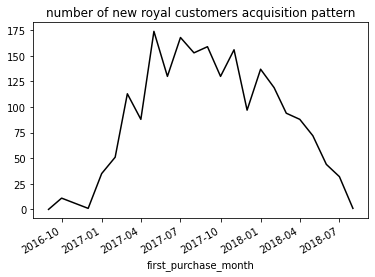

In [33]:
retention_count.iloc[:,1:].sum(axis=1).plot(
    title='number of new royal customers acquisition pattern',
    color='k')

**Visualize some voucher customer purchases**

In [34]:
#visualize customer voucher purchase amounts 
payments_customers = pd.merge(payments, customers, how='left', on='customer_id',left_index=True)

voucher_list = payments_customers[payments_customers['payment_type']=='voucher'].order_id.tolist()
vouchers = payments_customers[payments_customers.order_id.isin(voucher_list)]

#histogram
fig = px.histogram(vouchers, x="order_purchase_timestamp", y='payment_value',
                   color_discrete_sequence= px.colors.sequential.Plasma_r,
                   color='payment_type', title='sales using vouchers')
fig.update_layout(bargap=0.2)

In [77]:
#counting repurchase customer numbers
retention_count = pd.pivot_table(customers_orders.query('order_id==@voucher_list'), index=['first_purchase_month'],values=['customer_unique_id'],
                    columns=['diff_month'], aggfunc='count')
retention_count.fillna('')

customer_unique_id                                       \
diff_month                           0   1  2  3  4  5  6  7  8  9  10 11 12   
first_purchase_month                                                           
2016-10-01                         27.0                                 2      
2017-01-01                         80.0                                        
2017-02-01                        156.0   2                       1            
2017-03-01                        268.0   2     6           2        2         
2017-04-01                        264.0            2     4  2                  
2017-05-01                        390.0      3  2     3  1  2  4               
2017-06-01                        312.0   5        2  1  4     2  2  2  3      
2017-07-01                        455.0  25  9     2     6        1     2  1   
2017-08-01                        351.0   2                          1     1   
2017-09-01                        372.0   4  2     7  3     1        4         
2017-10-01                        390.0   5              1     3               
2017-11-01                        518.0   8  9  2  2  3                        
2017-12-01                        407.0   1  1  5     3                        
2018-01-01                        547.0   3  2  4  2  4  2  2                  
2018-02-01                        406.0   2  7  3  4     2                     
2018-03-01                        540.0   4     2  2  2                        
2018-04-01                        468.0   4  3     2                           
2018-05-01                        415.0   8     2                              
2018-06-01                        436.0   6                                    
2018-07-01                        392.0   2                                    
2018-08-01                        328.0   1                                    

                            
diff_month           15 16  
first_purchase_month        
2016-10-01                  
2017-01-01                  
2017-02-01                  
2017-03-01            2  1  
2017-04-01                  
2017-05-01            2     
2017-06-01                  
2017-07-01                  
2017-08-01                  
2017-09-01                  
2017-10-01                  
2017-11-01                  
2017-12-01                  
2018-01-01                  
2018-02-01                  
2018-03-01                  
2018-04-01                  
2018-05-01                  
2018-06-01                  
2018-07-01                  
2018-08-01

## Putting all numerical information into a single table

In [35]:
df_customers = customers_orders.groupby('customer_unique_id').agg({'order_id':'count',
                                                 'recency':'max',
                                                'order_approval_hours':'mean',
                                                'order_delivery_days':'mean',
                                                'order_delivery_delay':'mean',
                                                'diff_month':'max'
                                                })

print(df_customers.shape)
df_customers.head()

(94399, 6)


,order_id,recency,order_approval_hours,order_delivery_days,order_delivery_delay,diff_month
customer_unique_id,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,-160.273507,0.247500,4.521262,-4.132905,0
0000b849f77a49e4a4ce2b2a4ca5be3f,1,-163.263090,7.238056,1.239375,-4.248125,0
0000f46a3911fa3c0805444483337064,1,-585.850868,0.000000,23.069641,-1.389734,0
0000f6ccb0745a6a4b88665a16c9f078,1,-369.875428,0.326667,19.051921,-11.108970,0
0004aac84e0df4da2b147fca70cf8255,1,-336.905972,0.352778,11.136644,-7.035463,0


In [36]:
df_customers.isna().sum()

order_id                   0
recency                    0
order_approval_hours      13
order_delivery_days     1050
order_delivery_delay    1049
diff_month                 0
dtype: int64

In [54]:
#-------------constuct a single detailed transaction table-------------------

dfs = [df_customers,df_payments, df_categories, df_reviews,df_geo]
customers = reduce(lambda left,right: left.merge(right,how='left',left_index=True,right_index=True), dfs)

customers = customers.rename(columns={"order_id": "frequency", "payment_value": "monetary"})

print(customers.shape)
customers.head()

(94399, 24)


,frequency,recency,order_approval_hours,order_delivery_days,order_delivery_delay,diff_month,monetary,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,...,prod-bed_bath_table,prod-health_beauty,prod-sports_leisure,prod-furniture_decor,prod-computers_accessories,prod-others,quantity,review_score,geolocation_lat,geolocation_lng
customer_unique_id,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,-160.273507,0.247500,4.521262,-4.132905,0,141.90,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,-23.335331,-46.828647
0000b849f77a49e4a4ce2b2a4ca5be3f,1,-163.263090,7.238056,1.239375,-4.248125,0,27.19,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,4.0,-23.567395,-46.792957
0000f46a3911fa3c0805444483337064,1,-585.850868,0.000000,23.069641,-1.389734,0,86.22,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,3.0,-27.543787,-48.625680
0000f6ccb0745a6a4b88665a16c9f078,1,-369.875428,0.326667,19.051921,-11.108970,0,43.62,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,4.0,-1.311011,-48.482884
0004aac84e0df4da2b147fca70cf8255,1,-336.905972,0.352778,11.136644,-7.035463,0,196.89,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,5.0,-23.504368,-47.466156


In [55]:
#get the statistiques of each column
df_descibe = customers.describe().transpose()

#Calculate  NA
df_na = pd.DataFrame(customers.isna().sum(), columns=['na'])
df_na["na%"] = customers.isna().mean()
df_na['na%'] = pd.Series(['{:.2f}%'.format(val * 100) for val in df_na['na%']], index = df_na.index)

#LEs mettre dans un tableau
df_synth = pd.merge(df_descibe,df_na, how='right', right_index=True,left_index=True)
pd.set_option("display.max_columns", None)

#displaying the dataset information
pd.set_option("max_rows", None)
display(df_synth.fillna('-').round(4))

,count,mean,std,min,25%,50%,75%,max,na,na%
frequency,94399.0,1.0797,0.4576,1.0000,1.0000,1.0000,1.0000,33.0000,0,0.00%
recency,94399.0,-286.8575,152.7221,-772.8437,-395.7211,-267.7896,-163.1509,-44.3495,0,0.00%
order_approval_hours,94386.0,10.3077,20.6102,0.0000,0.2164,0.3472,14.6288,784.0456,13,0.01%
order_delivery_days,93349.0,9.3426,8.7651,-16.0962,4.1153,7.1060,12.0334,205.1910,1050,1.11%
order_delivery_delay,93350.0,-11.1509,10.1402,-146.0161,-16.2272,-11.7548,-6.3936,188.9751,1049,1.11%
diff_month,94399.0,0.0878,0.8294,0.0000,0.0000,0.0000,0.0000,20.0000,0,0.00%
monetary,94398.0,165.2543,226.1368,9.5900,63.1000,107.7800,182.6100,13664.0800,1,0.00%
payment_type_boleto,94398.0,0.2055,0.4181,0.0000,0.0000,0.0000,0.0000,6.0000,1,0.00%
payment_type_credit_card,94398.0,0.7991,0.4741,0.0000,1.0000,1.0000,1.0000,16.0000,1,0.00%
payment_type_debit_card,94398.0,0.0160,0.1267,0.0000,0.0000,0.0000,0.0000,2.0000,1,0.00%


In [56]:
pd.reset_option('^display.', silent=True)

In [57]:
customers=customers.fillna(customers.mean()).reset_index()
#save to a csv file
customers.to_csv(os. getcwd()+'\\output\\customers.csv', index=False)

## RFM Segmentation
### Aggregating and computing RFM variables for each customer

In [58]:
#get rfm & satisfaction information
rfm_reviews= customers[['customer_unique_id','recency','frequency','monetary','review_score']]
rfm_reviews.to_csv(os. getcwd()+'\\output\\rfm_reviews.csv', index=False)

#get only FDM for manual analyse
rfm = rfm_reviews.iloc[:,:4]

print(rfm.shape)
rfm.head()

(94399, 4)


,customer_unique_id,recency,frequency,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,-160.273507,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,-163.263090,1,27.19
2,0000f46a3911fa3c0805444483337064,-585.850868,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,-369.875428,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,-336.905972,1,196.89


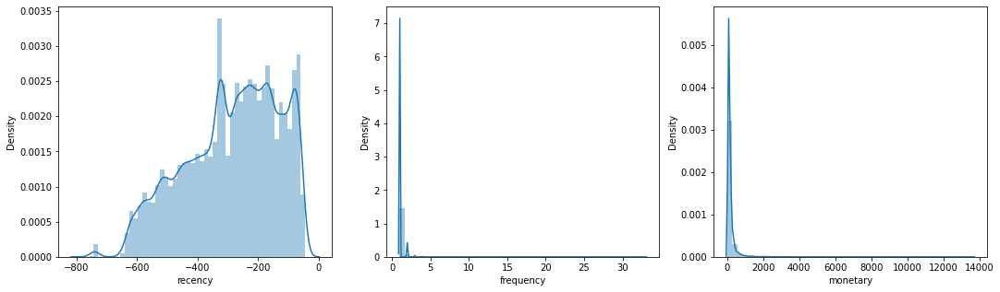

In [42]:
fig, axes = plt.subplots(1,3,figsize=(18,5))
for i, feature in enumerate(list(rfm.columns[1:])):
    sns.distplot(rfm[feature], ax=axes[i])

<AxesSubplot:>

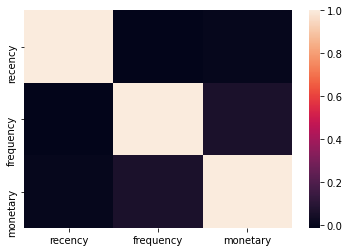

In [43]:
sns.heatmap(rfm[1:].corr())

###  Assigning RFM scores 

**defining quantiles**

In [86]:
def Scoring(x,p,d):
    """
    create ‘quantile’ on each of the metrics and assigning the required order.
      
    """
    if x <= d[p][0.20]:
        return 0
    elif x <= d[p][0.40]:
        return 1
    elif x <= d[p][0.60]:
        return 2
    elif x <= d[p][0.80]: 
        return 3
    elif x <= d[p][0.95]: 
        return 4
    else:
        return 5
    
#Split into four segments using quantiles
quantiles = rfm.quantile(q=[0.2,0.4,0.6,0.8,0.95]).to_dict()


**labeling FDM ranges**

In [119]:
#import reference file
rfm_reference = pd.read_csv(inputWD + 'rfm_reference.txt', sep='\t')
rfm_reference

,customer_segment,activity,actionable_tip,r_range,fm_range
0,Champions,"Bought recently, buy often and spend the most!",Reward them. Can be early adopters for new pro...,4-5,4-5
1,Loyal Customers,Spend good money with us often. Responsive to ...,Upsell higher value products. Ask for reviews....,2-5,3-5
2,Potential Loyalist,"Recent customers, but spent a good amount and ...","Offer membership / loyalty program, recommend ...",3-5,0-5
3,Recent Customers,"Bought most recently, but not often.","Provide on-boarding support, give them early s...",4-5,0-1
4,Promising,"Recent shoppers, but haven’t spent muc","Create brand awareness, offer free trials",3-4,0-1
5,Customers Needing Attention,"Above average recency, frequency and monetary ...","Make limited time offers, Recommend based on p...",2-3,2-3
6,About To Sleep,"Below average recency, frequency and monetary ...","Share valuable resources, recommend popular pr...",2-3,0-2
7,At Risk,Spent big money and purchased often. But long ...,"Send personalized emails to reconnect, offer r...",1-2,3-5
8,Can’t Lose Them,"Made biggest purchases, and often. But haven’t...","Win them back via renewals or newer products, ...",1-3,4-5
9,Hibernating,"Last purchase was long back, low spenders and ...",Offer other relevant products and special disc...,2-3,0-4


In [120]:
#defining customer group according to a reference table

#constructing a table with rfm combinaitions
rfm_ref_values=[]
for i in range(len(rfm_reference)):
    g=rfm_reference.iloc[i,:]
    #get all the possible combinations for one group
    for r in range(int(g.r_range[0]), int(g.r_range[2])+1):
        for f in range(int(g.fm_range[0]), int(g.fm_range[2])+1):
            for m in range(int(g.fm_range[0]), int(g.fm_range[2])+1): 
                combinaition=[g.customer_segment, str(r)+str(f)+str(m)]
                rfm_ref_values.append(combinaition)
rfm_ref_values=pd.DataFrame(rfm_ref_values, columns=['customer_segment','rfm_group'])\
.groupby('rfm_group').first().reset_index()


In [121]:
rfm_ref_values

,rfm_group,customer_segment
0,000,Lost
1,001,Lost
2,002,Lost
3,003,Lost
4,004,Lost
...,...,...
211,551,Potential Loyalist
212,552,Potential Loyalist
213,553,Loyal Customers
214,554,Champions


**labeling customers according the FDM scores**

In [122]:
#Calculate Add R, F and M segment value columns in the existing dataset to show R, F and M segment values
df_scores=rfm.copy()
df_scores['R'] = rfm['recency'].apply(Scoring, args=('recency',quantiles,))
df_scores['F'] = rfm['frequency'].apply(Scoring, args=('frequency',quantiles,))
df_scores['M'] = rfm['monetary'].apply(Scoring, args=('monetary',quantiles,))

#Calculate and Add RFMGroup value column showing combined concatenated score of RFM
df_scores['rfm_group'] = df_scores.R.map(str) + df_scores.F.map(str) + df_scores.M.map(str)
#Assign Loyalty Level to each customer
df_scores=df_scores.merge(rfm_ref_values, how='left', on='rfm_group', left_index=True)

print(df_scores.shape)
df_scores.head()

(94399, 9)


,customer_unique_id,recency,frequency,monetary,R,F,M,rfm_group,customer_segment
111,0000366f3b9a7992bf8c76cfdf3221e2,-160.273507,1,141.90,3,0,3,303,Potential Loyalist
108,0000b849f77a49e4a4ce2b2a4ca5be3f,-163.263090,1,27.19,3,0,0,300,Potential Loyalist
1,0000f46a3911fa3c0805444483337064,-585.850868,1,86.22,0,0,1,001,Lost
36,0000f6ccb0745a6a4b88665a16c9f078,-369.875428,1,43.62,1,0,0,100,Lost
39,0004aac84e0df4da2b147fca70cf8255,-336.905972,1,196.89,1,0,3,103,Lost


In [123]:
fig = px.scatter(df_scores.fillna('-'), x="recency", y="monetary",
         size="frequency", color="customer_segment",
              hover_name="rfm_group",  size_max=30)
fig.show()